# Understand the theory behind diffusion model

In [1]:
# generate an image for testing
# Load up model
import torch
from diffusers import StableDiffusionPipeline

text2img_pipe = StableDiffusionPipeline.from_pretrained(
    "stablediffusionapi/deliberate-v2"
    , torch_dtype = torch.float16
).to("cuda:0")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

C:\Users\Asus\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\transformers\models\clip\feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


  0%|          | 0/50 [00:00<?, ?it/s]

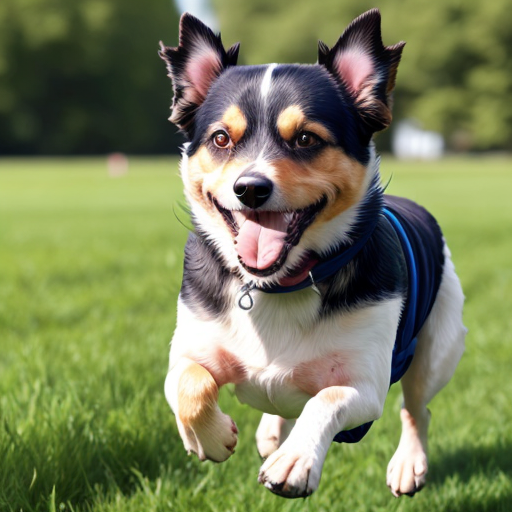

In [2]:
generator = torch.Generator("cuda:0").manual_seed(2)
prompt = "high quality,a happy dog running on the grass"
image = text2img_pipe(
    prompt = prompt
    , generator = generator
).images[0]
image.save("dog.png")
image

## Add Gaussian noise to an image

C:\Users\Asus\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\ipyplot\_utils.py:95: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  return np.asarray(seq, dtype=type(seq[0]))



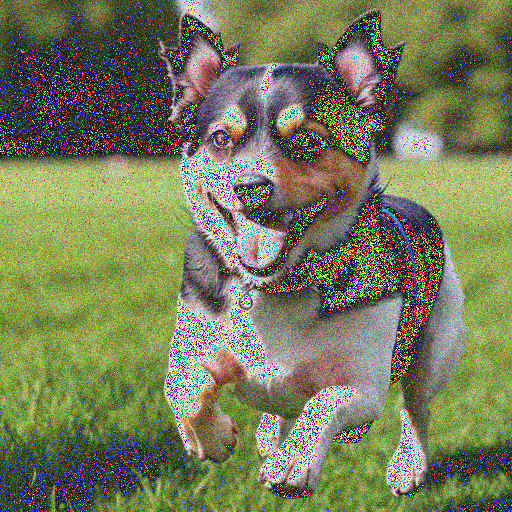
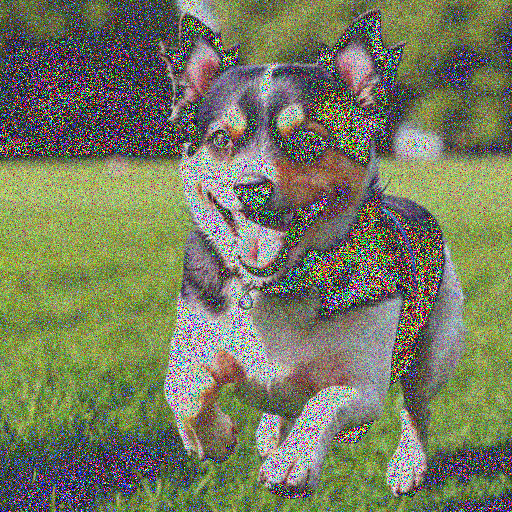
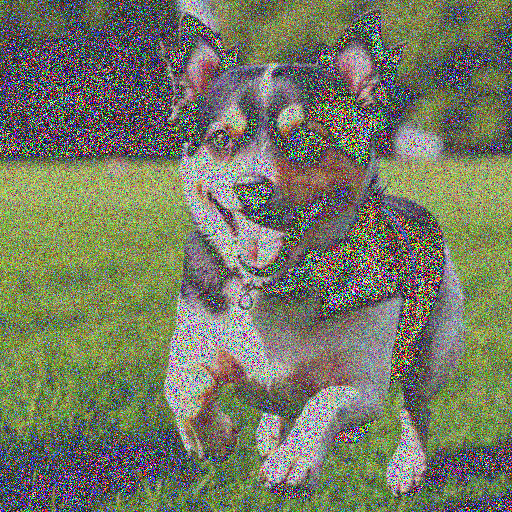
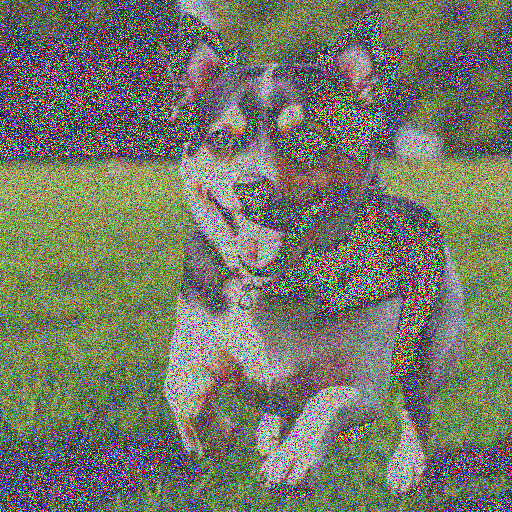
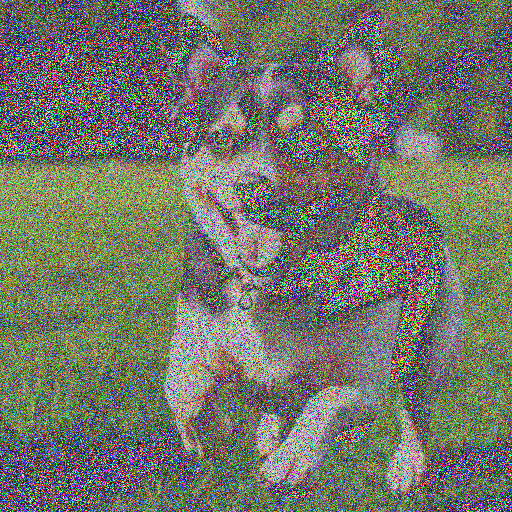
...
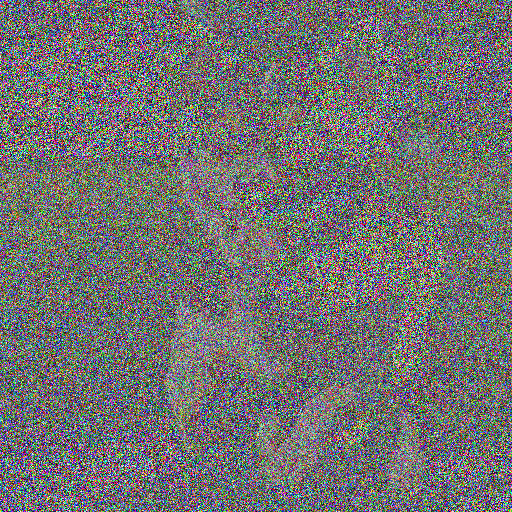
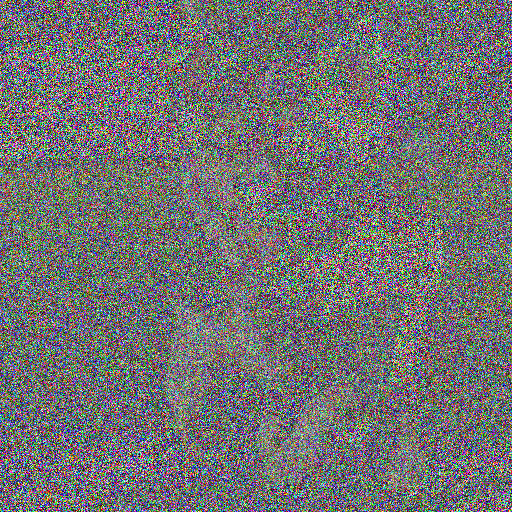
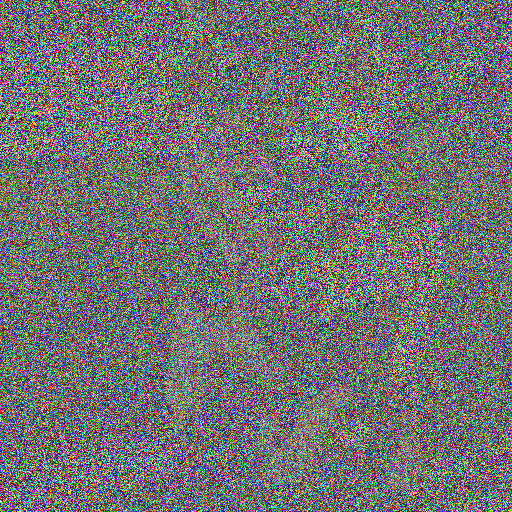
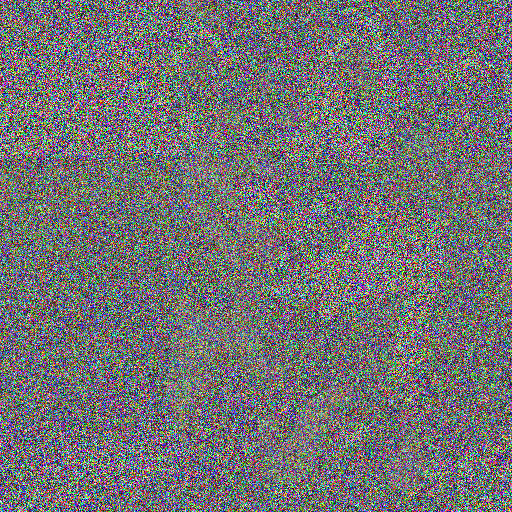
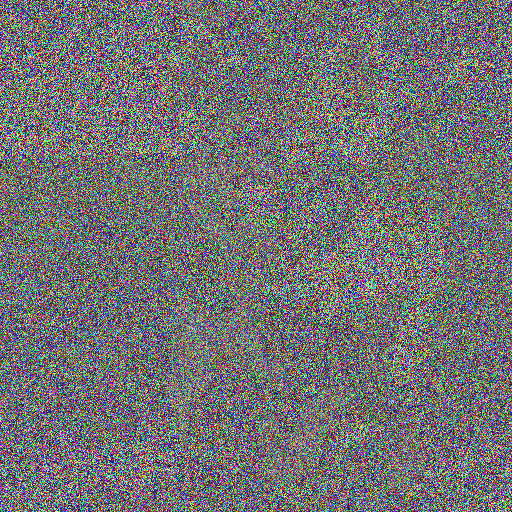

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import ipyplot
from PIL import Image

# Load a grayscale image
img_path = r"dog.png"
image = plt.imread(img_path)

# Parameters
num_iterations = 16
beta = 0.1              # noise_variance

images = []
steps = ["Step:"+str(i) for i in range(num_iterations)]

# Forward diffusion process
for i in range(num_iterations):
    mean = np.sqrt(1 - beta) * image
    image = np.random.normal(mean, beta, image.shape)
    
    # convert image to PIL image object
    pil_image = Image.fromarray((image * 255).astype('uint8'), 'RGB')
    
    images.append(pil_image)

ipyplot.plot_images(images, labels=steps, img_width=120)

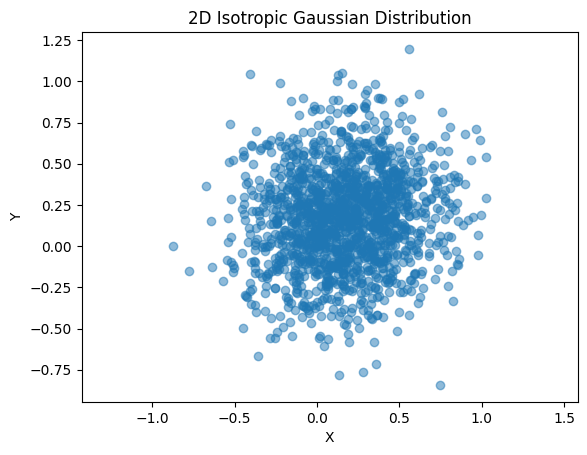

In [4]:
sample_img = image

plt.scatter(sample_img[:, 0], sample_img[:, 1], alpha=0.5)
plt.title("2D Isotropic Gaussian Distribution")
plt.xlabel("X")
plt.ylabel("Y")
plt.axis("equal")
plt.show()

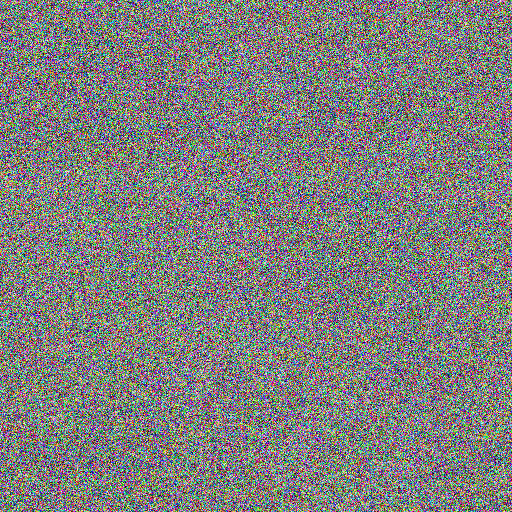

In [5]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from itertools import accumulate

def get_product_accumulate(numbers):
    product_list = list(accumulate(numbers, lambda x, y: x * y))
    return product_list

# Load a grayscale image
img_path = r"dog.png"
image = plt.imread(img_path)
image = image * 2 - 1                   # [0,1] to [-1,1]

# Parameters
num_iterations = 20
beta = 0.05                             # noise_variance
betas = [beta]*num_iterations

alpha_list = [1 - beta for beta in betas]

alpha_bar_list = get_product_accumulate(alpha_list)

target_index = 19
x_target = (
    np.sqrt(alpha_bar_list[target_index]) * image 
    + np.sqrt(1 - alpha_bar_list[target_index]) * np.random.normal(0,1,image.shape)
)

x_target = (x_target+1)/2

x_target = Image.fromarray((x_target * 255).astype('uint8'), 'RGB')
display(x_target)

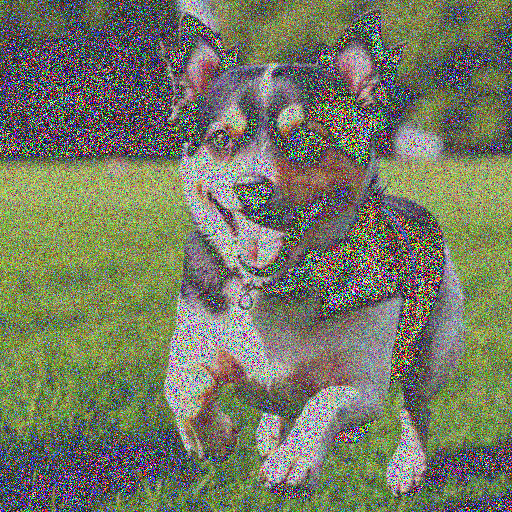

In [6]:
images[2]